# Coding Challenge – Sereact Instance Segmentation

In this colab, I trained a detectron2 pretrained model with configuration COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x on a new dataset using the Detectron2 framework.

# Install detectron2

In [2]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Using cached PyYAML-5.1.tar.gz (274 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
fatal: destination path 'detectron2' already exists and is not an empty directory.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment


In [3]:
%cd /content/detectron2

/content/detectron2


In [4]:
! pwd

/content/detectron2


In [5]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.3 ; cuda:  cu121
detectron2: 0.6


In [6]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

This section shows how to train an existing detectron2 model on a custom dataset in a new format.

We use a custom segmentation dataset which is in coco format, with 14 classes ie.: persons, cars, fruits, dogs etc. We'll train an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

# Data Preparation

Register the custom dataset to detectron2.

In [7]:
! pwd

/content/detectron2


In [8]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("sample", {}, "/content/detectron2/data/train.json", "/content/detectron2/data/images")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

In [9]:
#Retrieving metadata and dataset information for a dataset that has been registered in Detectron2
sample_metadata = MetadataCatalog.get("sample")
dataset_dicts = DatasetCatalog.get("sample")

WARNING [08/24 14:17:54 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/24 14:17:54 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/detectron2/data/train.json


Visualize a few of the images

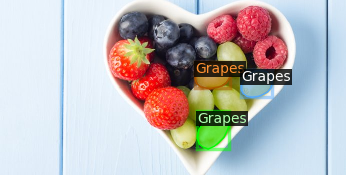

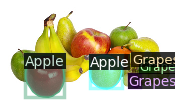

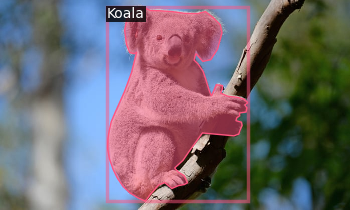

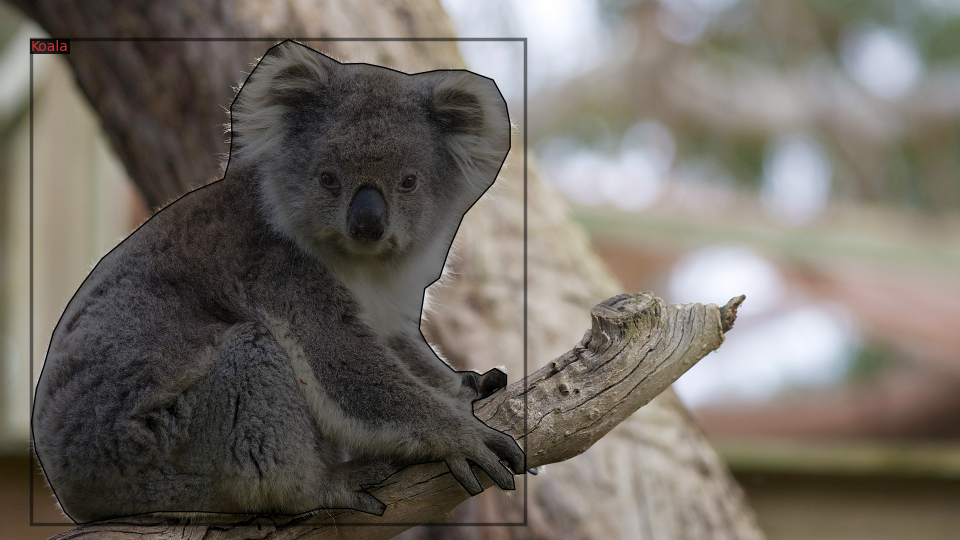

In [10]:
import random

for d in random.sample(dataset_dicts, 4):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the dataset.

In [11]:
import torch
print("CUDA available:", torch.cuda.is_available())

CUDA available: True


In [12]:
!nvidia-smi

Sat Aug 24 14:18:15 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   40C    P8              17W /  72W |      4MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [13]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("sample",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 500    # 500 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 14  # There are 14 classes in the dataset.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/24 14:18:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[08/24 14:18:21 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/24 14:18:31 d2.utils.events]:  eta: 0:02:53  iter: 19  total_loss: 4.035  loss_cls: 2.692  loss_box_reg: 0.6196  loss_mask: 0.6914  loss_rpn_cls: 0.03106  loss_rpn_loc: 0.01023    time: 0.3414  last_time: 0.3738  data_time: 0.0107  last_data_time: 0.0030   lr: 9.7405e-06  max_mem: 2669M
[08/24 14:18:40 d2.utils.events]:  eta: 0:02:38  iter: 39  total_loss: 3.756  loss_cls: 2.482  loss_box_reg: 0.5764  loss_mask: 0.6891  loss_rpn_cls: 0.03506  loss_rpn_loc: 0.01217    time: 0.3257  last_time: 0.2099  data_time: 0.0055  last_data_time: 0.0045   lr: 1.9731e-05  max_mem: 2669M
[08/24 14:18:46 d2.utils.events]:  eta: 0:02:28  iter: 59  total_loss: 3.305  loss_cls: 2.087  loss_box_reg: 0.5634  loss_mask: 0.6806  loss_rpn_cls: 0.02972  loss_rpn_loc: 0.01185    time: 0.3141  last_time: 0.2513  data_time: 0.0053  last_data_time: 0.0049   lr: 2.972e-05  max_mem: 2670M
[08/24 14:18:52 d2.utils.events]:  eta: 0:02:18  iter: 79  total_loss: 2.801  loss_cls: 1.505  loss_box_reg: 0.651  loss_mask

This part is used for setting up and running inference with the model using the Detectron2 framework.

In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("sample", )
predictor = DefaultPredictor(cfg)

[08/24 14:21:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [15]:
%pwd

'/content/detectron2'

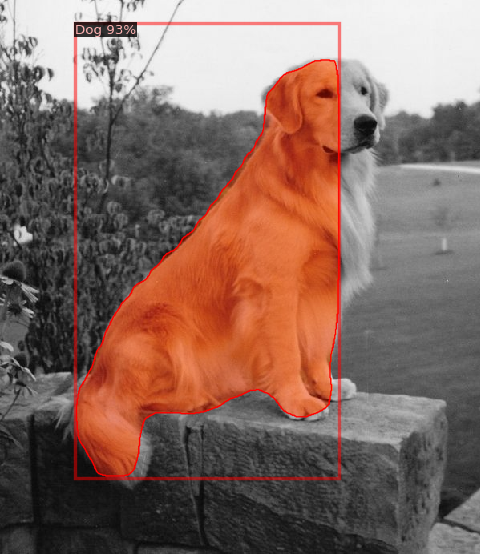

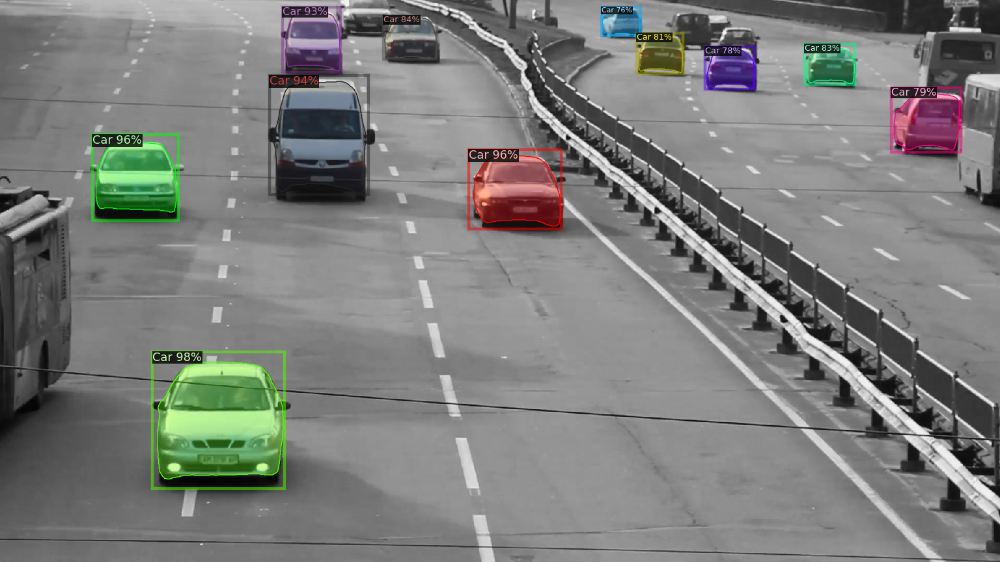

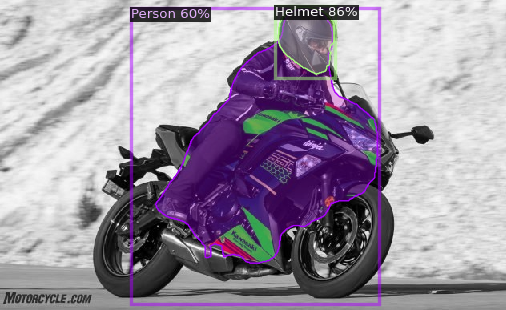

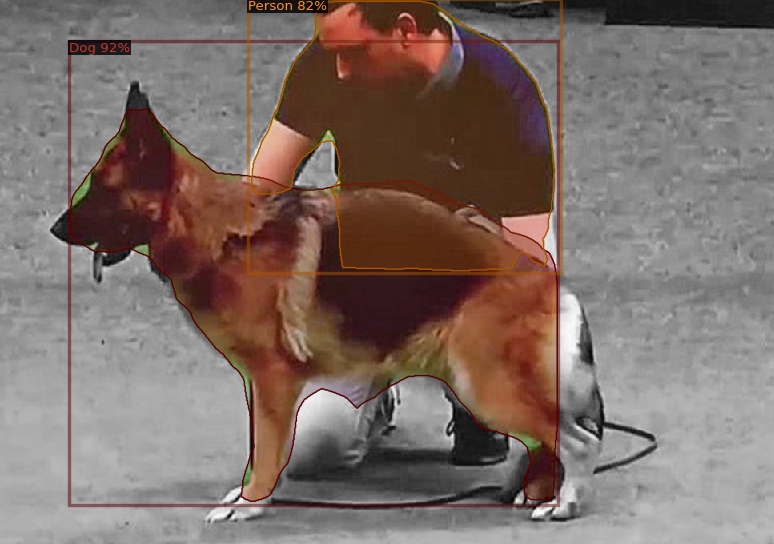

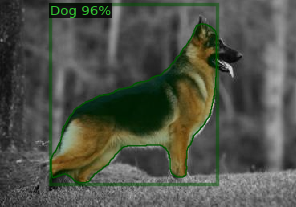

...

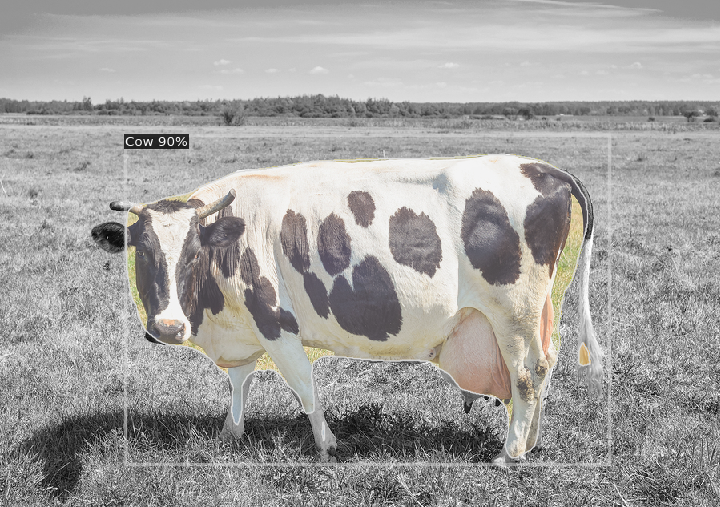

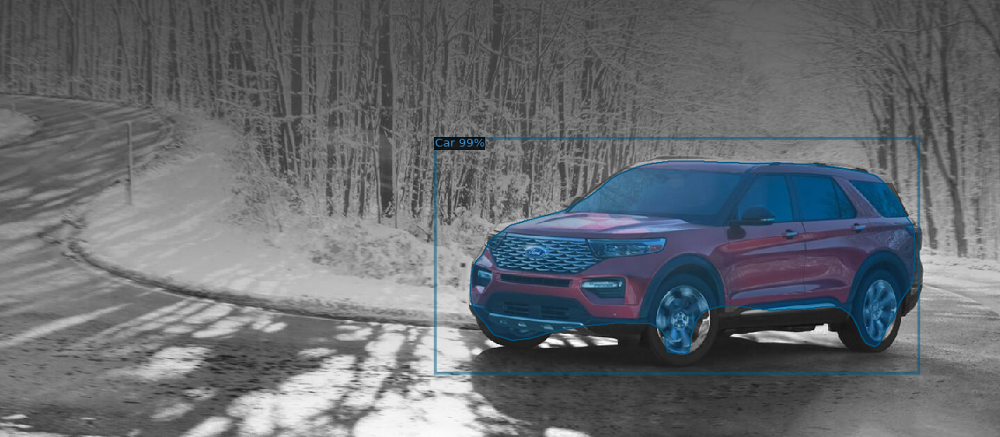

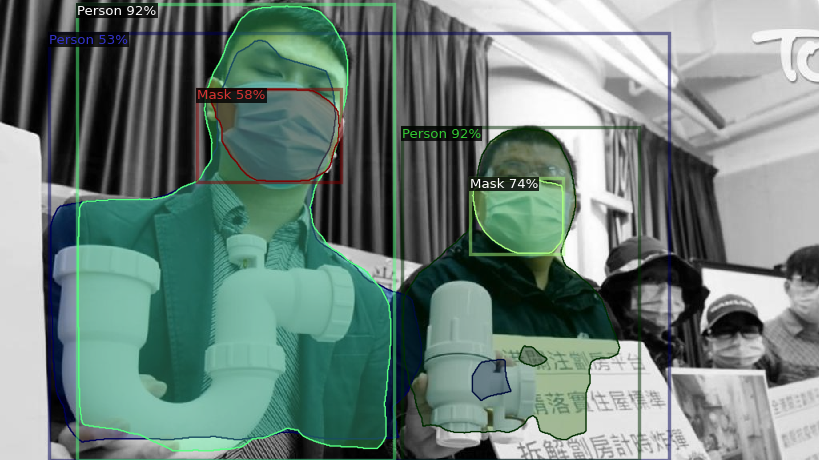

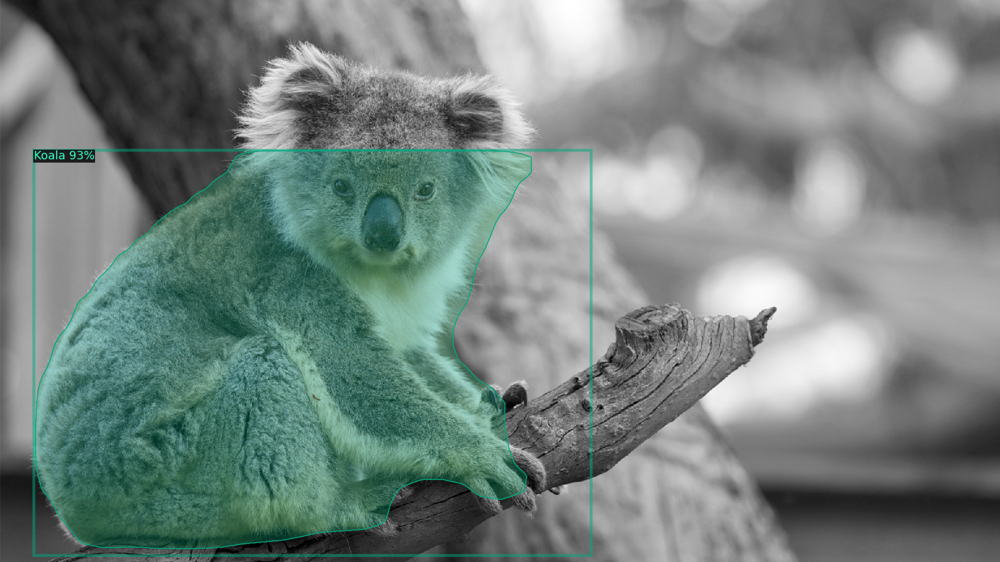

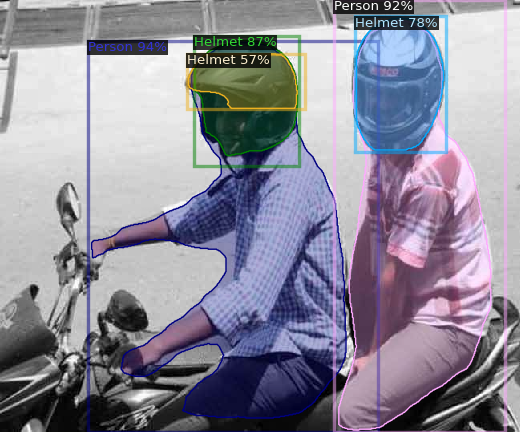

In [16]:
from detectron2.utils.visualizer import ColorMode
import os
import cv2
from google.colab.patches import cv2_imshow

data_path = "/content/detectron2/data/test_data/"

for d in os.listdir(data_path):
    im = cv2.imread(os.path.join(data_path, d))
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


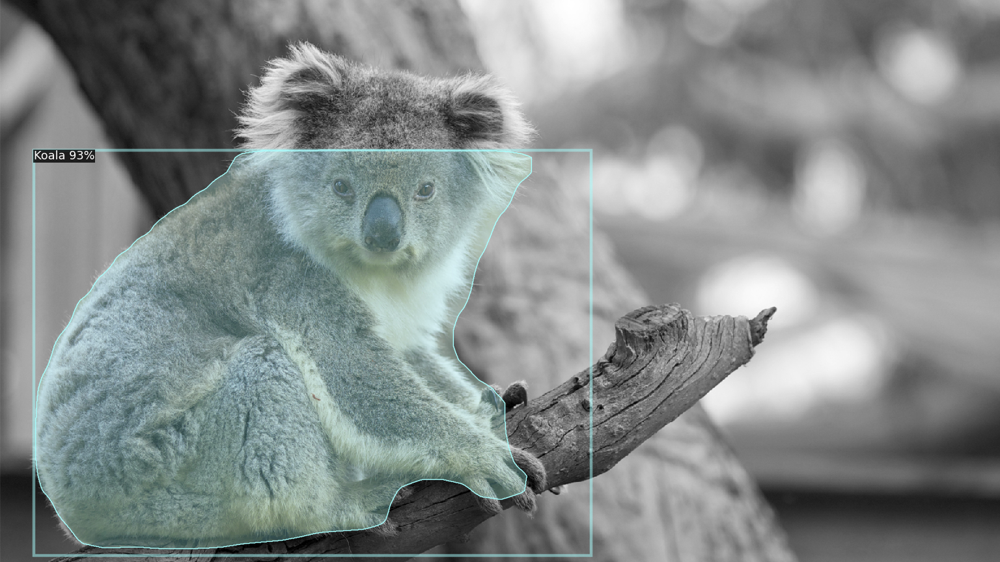

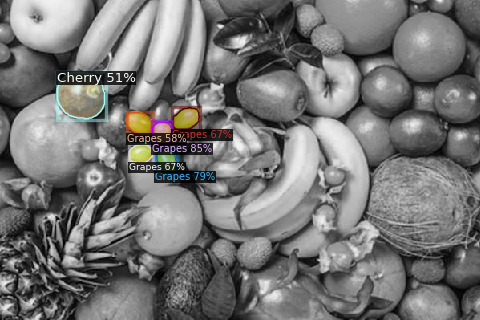

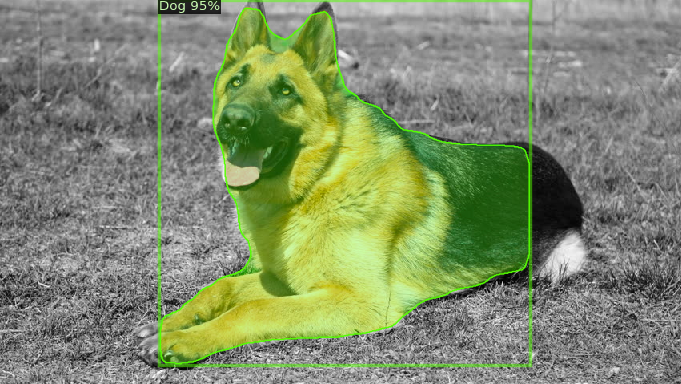

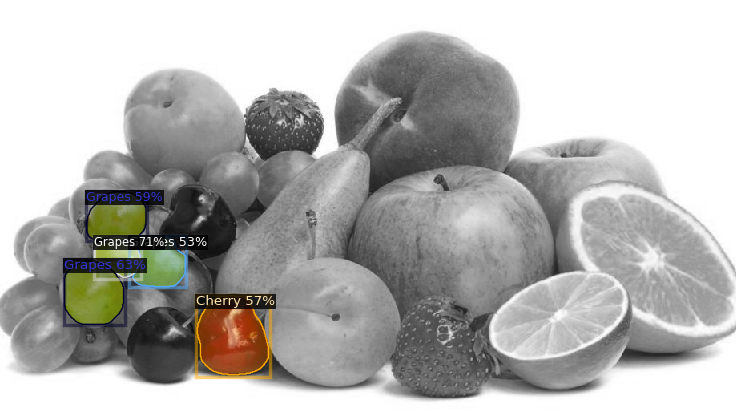

In [17]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 4):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata,
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

# Evaluation

In [18]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("sample", output_dir= "./output")
val_loader = build_detection_test_loader(cfg, "sample")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[08/24 14:25:44 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [08/24 14:25:44 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/24 14:25:44 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/detectron2/data/train.json
[08/24 14:25:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/24 14:25:44 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[08/24 14:25:44 d2.data.common]: Serializing 51 elements to byte tensors and concatenating them all ...
[08/24 14:25:44 d2.data.common]: Serialized dataset takes 0.13 MiB
[08/24 14:25:44 d2.evaluation.evaluator]: Start inference on 51 batches


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/24 14:25:45 d2.evaluation.evaluator]: Inference done 11/51. Dataloading: 0.0013 s/iter. Inference: 0.0508 s/iter. Eval: 0.0022 s/iter. Total: 0.0543 s/iter. ETA=0:00:02
[08/24 14:25:48 d2.evaluation.evaluator]: Total inference time: 0:00:03.933434 (0.085509 s / iter per device, on 1 devices)
[08/24 14:25:48 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.069615 s / iter per device, on 1 devices)
[08/24 14:25:48 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/24 14:25:48 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08/24 14:25:48 d2.evaluation.coco_evaluation]: Evaluating predictions with official COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.05s).
Accumulating evaluation results...
DONE (t=0.06s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0

## Getting the custom config file

In [ ]:
f = open('config.yml', 'w')
f.write(cfg.dump())
f.close()